In [1]:
import os

import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torchvision.transforms as T
device = torch.device("cuda:0" if torch.cuda.is_available() else "mps" if torch.backends.mps.is_available() else "cpu")

from tqdm.notebook import tqdm
import wandb

import datetime
import time
import h5py

import utils
import models

%load_ext autoreload
%autoreload 2

general performance for a large earthquake at similar distance, with and without traffic
- 2023p202703, M4.7, heavy traffic, distance = 175 km

general performance for small earthquakes at increasing distances (with no traffic)
- 2023p215452, M2.7, no traffic, distance = 76 km

general performance for very small earthquakes very close to the fibre (less than array aperture - 30 km)
- 2023p273854, M1.9, minimal traffic, distance = 10 km

general performance for small earthquakes at increasing distances (with some traffic)
- 2023p181489, M3.3, some traffic, distance = 92 km
- 2023p197461, M3.6, some traffic, distance = 159 km
- 2023p215753, M3.1, some traffic, distance = 191 km

In [2]:
dpath = '../../data/earthquakes/sissle/eq_data_50Hz/'

train_picks = ['2023p214660', '2023p300579', '2023p303853', '2023p218553', '2023p326201', '2023p313442', 
               '2023p265881', '2023p171245', '2023p291534', '2023p293493', '2023p278798', '2023p321451', 
               '2023p166738', '2023p307984', '2023p273765', '2023p209788', '2023p326200', '2023p299899', 
               '2023p212693', '2023p303138', '2023p252684', '2023p167136', '2023p202039', '2023p235224', 
               '2023p272380', '2023p172434', '2023p152354', '2023p316959', '2023p178129']
test_picks = ['2023p202703', '2023p215452', '2023p273854', '2023p181489', '2023p197461', '2023p215753']

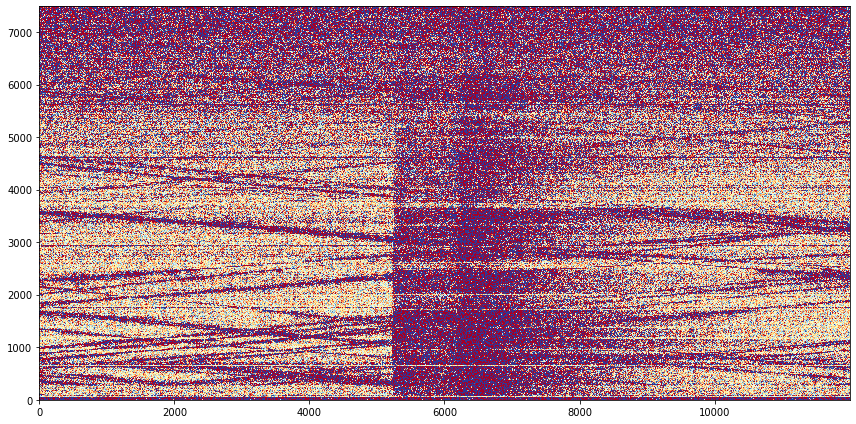

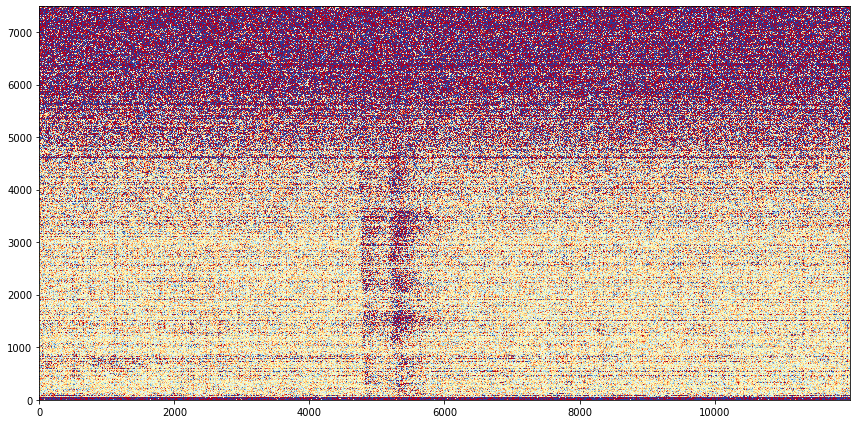

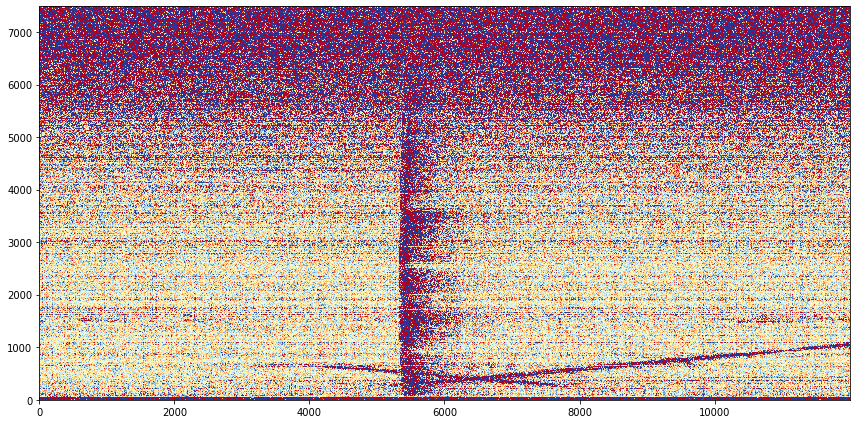

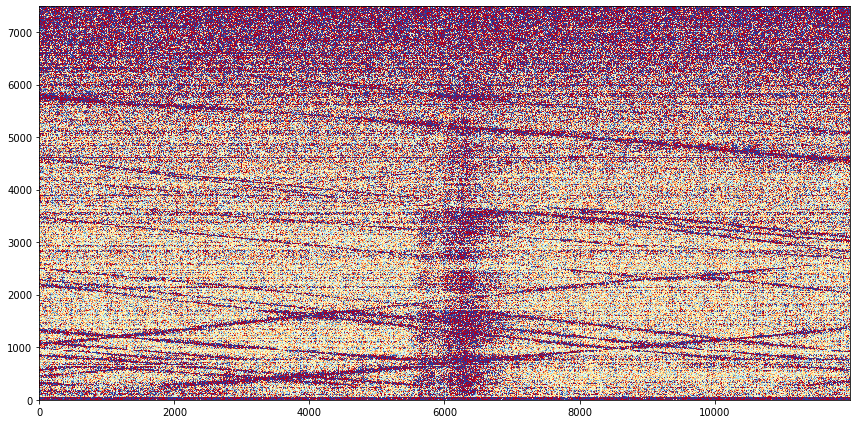

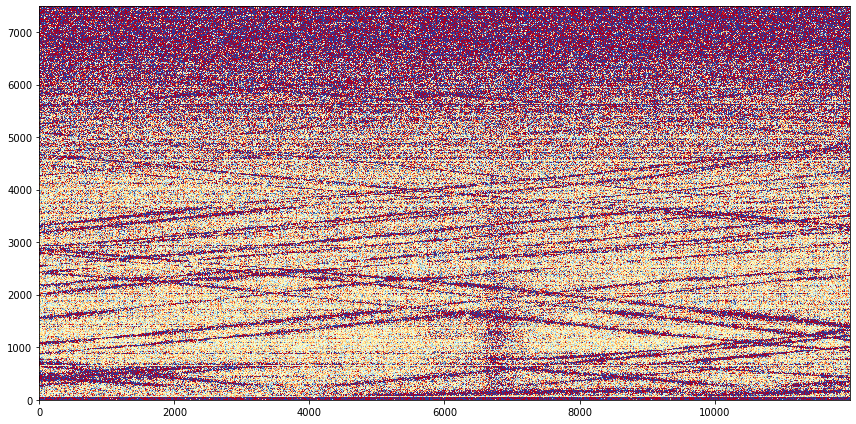

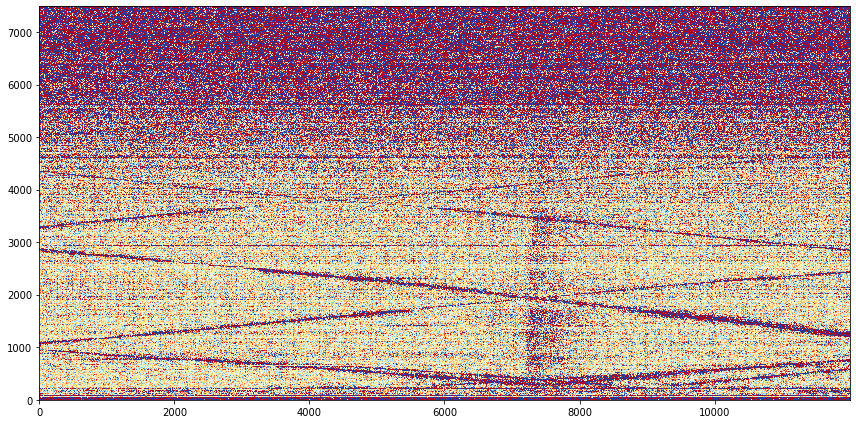

In [3]:
for pick in test_picks:

    data = np.hstack([h5py.File(dpath + pick + '/' + p)['DAS'][:].T for p in sorted([p for p in os.listdir(dpath + pick + '/')])])
    nx, nt = data.shape
    fig, ax = plt.subplots(1, 1, sharex=True, figsize=(12,6))
    ax.imshow(data, origin='lower', interpolation='nearest', cmap='RdYlBu', aspect='auto', vmin=-100, vmax=100)
    plt.tight_layout()
    plt.show()
    
    with h5py.File(dpath + 'test/' + pick + '.h5', 'w') as hf:
        hf.create_dataset('DAS', data=data)

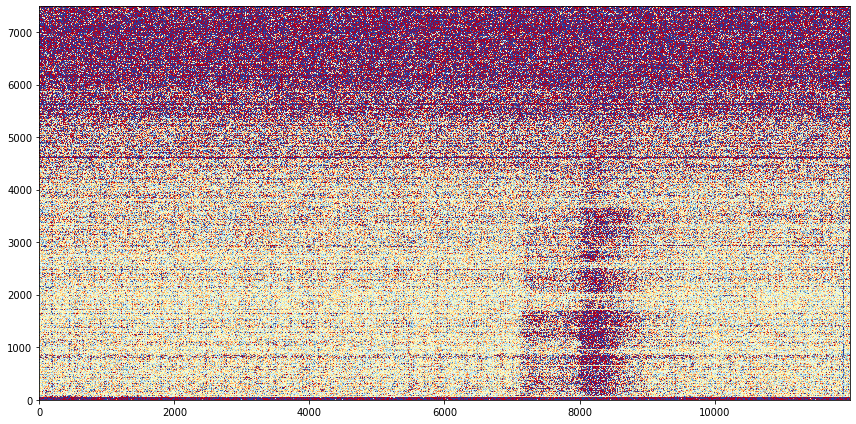

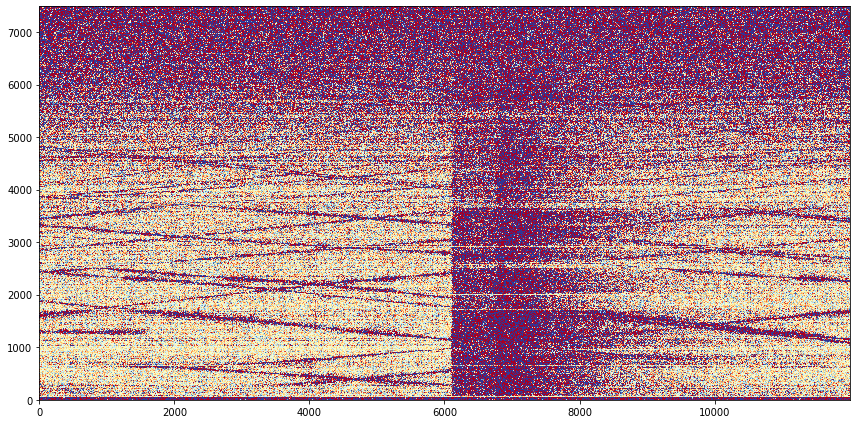

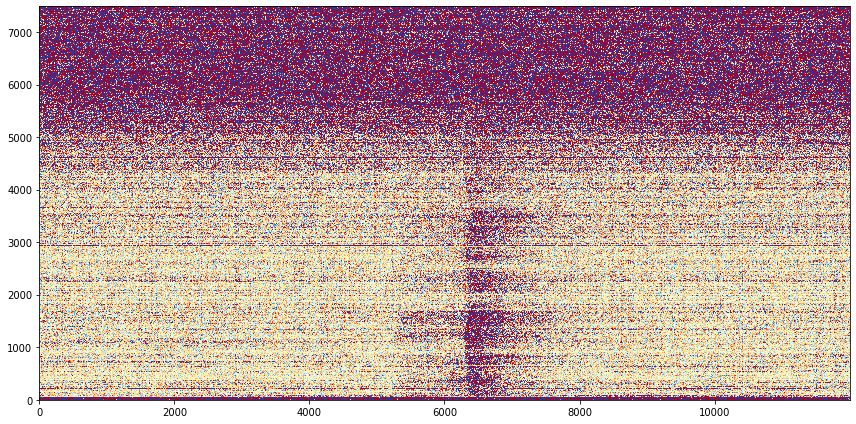

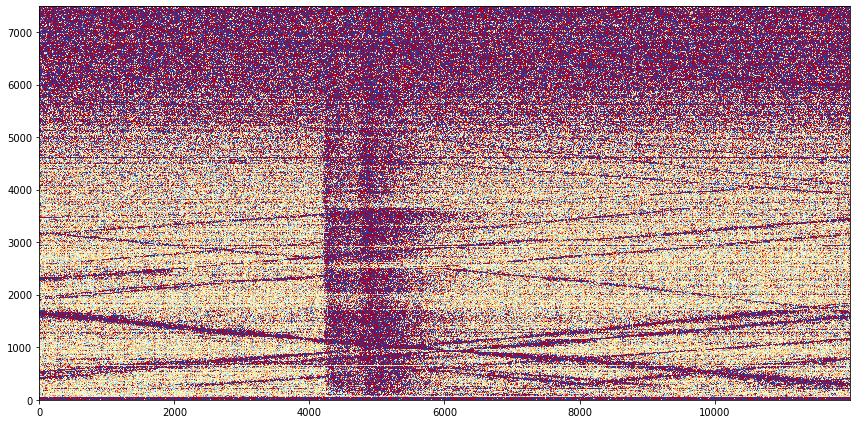

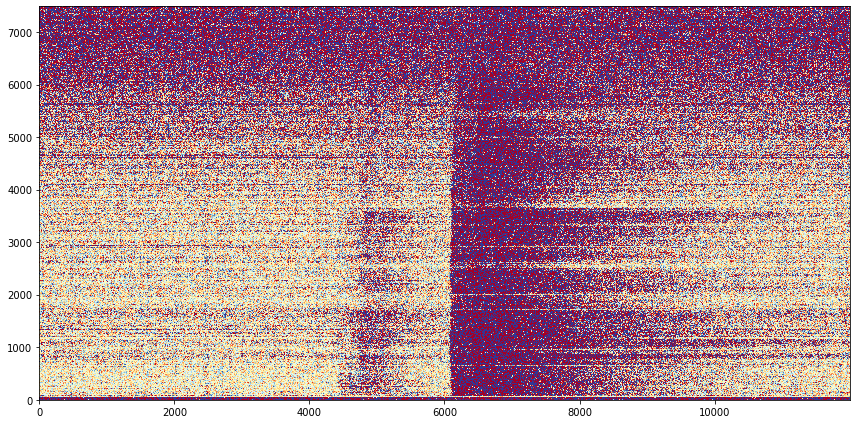

...

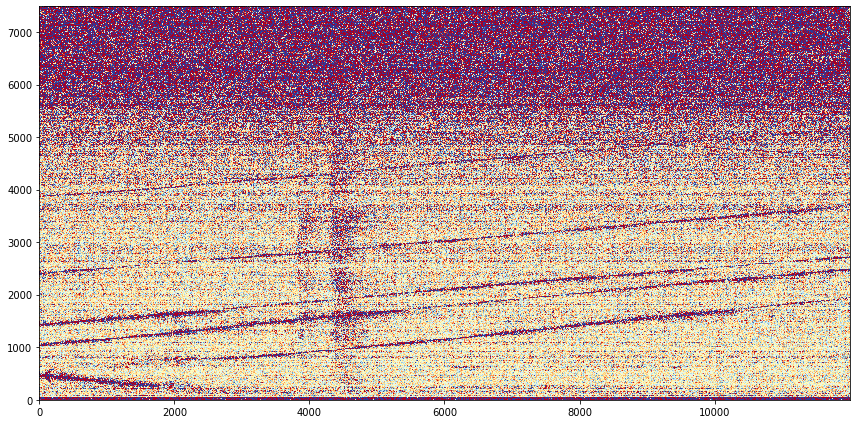

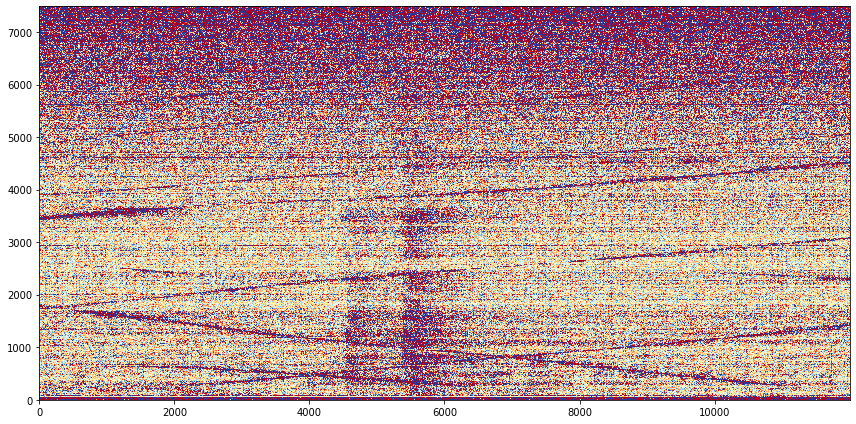

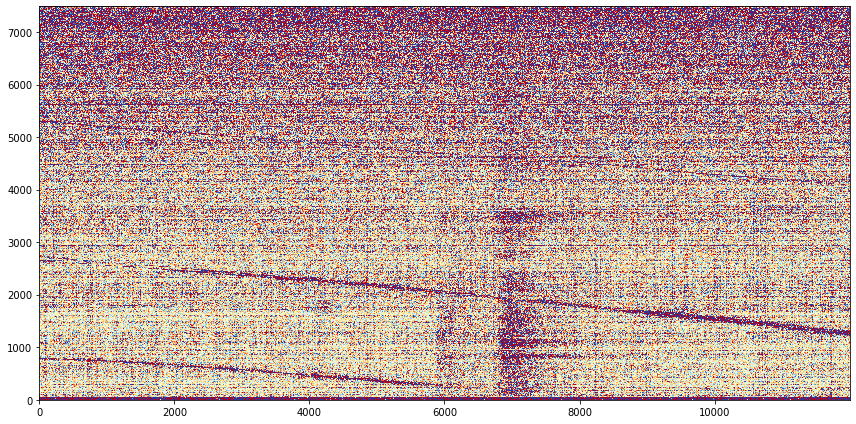

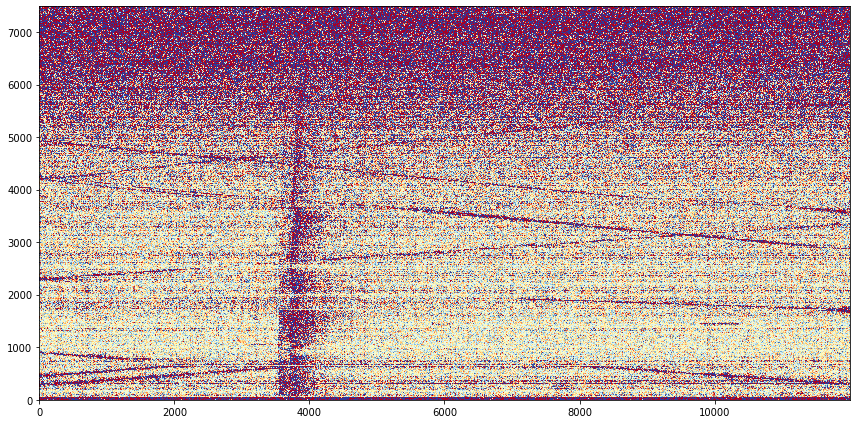

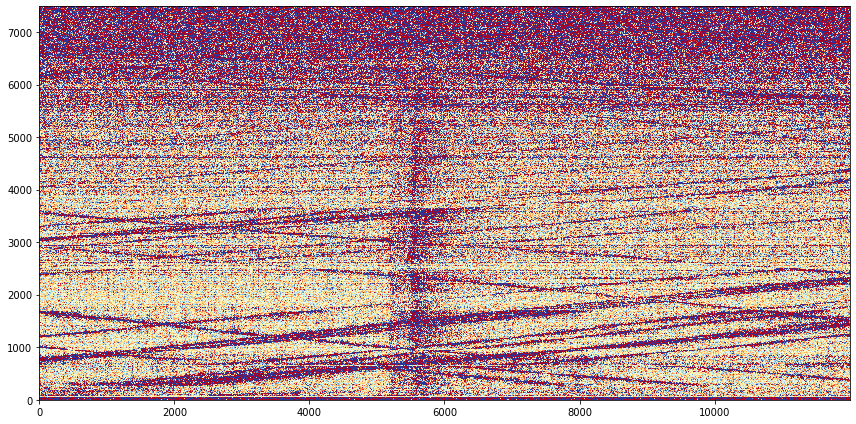

In [4]:
for i, (pick, idx) in enumerate(zip(train_picks, [8000,6750,6500,5000,6000,7000,5500,8000,5500,7000,9500,4000,6500,3750,6000,5000,6000,5000,6000,7000,6000,6000,6250,7500,5500,5000,7000,3750,5500])):

    data = np.hstack([h5py.File(dpath + pick + '/' + p)['DAS'][:].T for p in sorted([p for p in os.listdir(dpath + pick + '/')])])#[:,idx-1500:idx+1500]
    
    fig, ax = plt.subplots(1, 1, sharex=True, figsize=(12,6))
    ax.imshow(data, origin='lower', interpolation='nearest', cmap='RdYlBu', aspect='auto', vmin=-100, vmax=100)
    plt.tight_layout()
    plt.show()
    
    with h5py.File(dpath + 'train/{:02d}_'.format(i+1) + pick + '.h5', 'w') as hf:
        hf.create_dataset('DAS', data=data)

In [5]:
train_path = '../../data/earthquakes/sissle/eq_data_50Hz/train/'
sorted([train_path + f for f in os.listdir(train_path)])

['../../data/earthquakes/sissle/eq_data_50Hz/train/01_2023p214660.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/02_2023p300579.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/03_2023p303853.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/04_2023p218553.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/05_2023p326201.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/06_2023p313442.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/07_2023p265881.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/08_2023p171245.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/09_2023p291534.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/10_2023p293493.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/11_2023p278798.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/12_2023p321451.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/13_2023p166738.h5',
 '../../data/earthquakes/sissle/eq_data_50Hz/train/14_2023p307984.h5',
 '../.

In [6]:
train_path = '../../data/earthquakes/sissle/eq_data_50Hz/train/'
test_path = '../../data/earthquakes/sissle/eq_data_50Hz/test/'
train_paths = sorted([train_path + f for f in os.listdir(train_path)])
test_paths = sorted([test_path + f for f in os.listdir(test_path)])

train_real_data = []
for i, p in enumerate(train_paths):
    with h5py.File(p, 'r') as hf:
        train_real_data.append(hf['DAS'][81:][::5])
train_real_data = np.stack(train_real_data)

test_real_data = []
for i, p in enumerate(test_paths):
    with h5py.File(p, 'r') as hf:
        test_real_data.append(hf['DAS'][81:][::5])
test_real_data = np.stack(test_real_data)

train_real_data.shape, test_real_data.shape

((29, 1482, 12000), (6, 1482, 12000))